In [25]:
%matplotlib inline
from IPython.display import HTML


# Image Encryption and Analysis using Chaos Map

## 1. Introduction

In this notebook, we perform image encryption using a chaotic map, followed by a detailed analysis of the results. The analysis includes:
- Histogram Analysis
- Differential Analysis (NPCR, UACI)
- Entropy, Correlation Coefficient (HVD)
- Robustness Analysis (Noise & Cropping Attacks)
- Computation Time for Encryption & Decryption

The encryption technique used is based on XOR encryption with a randomly generated key, and performance metrics are assessed to evaluate robustness and efficiency.


## 2. Image Encryption and Decryption


In this section, we perform the initial image encryption using a chaotic map-based key for XOR encryption.

### Code:


In [1]:
import numpy as np
import cv2

# === Load original image ===
image_path = r"D:\crypto project\Image\image8.tiff"
image = cv2.imread(image_path, cv2.IMREAD_COLOR)
if image is None:
    raise FileNotFoundError("Original image not found")

# === Set a fixed seed and generate a random key ===
seed = 42
np.random.seed(seed)
key = np.random.randint(0, 256, size=image.shape, dtype=np.uint8)

# === Encrypt the image ===
encrypted_image = cv2.bitwise_xor(image, key)
cv2.imwrite(r"D:\crypto project\Image\encrypted_image.png", encrypted_image)

# === Decrypt the image ===
np.random.seed(seed)  # Re-seed to generate the same key
key_for_decryption = np.random.randint(0, 256, size=image.shape, dtype=np.uint8)
decrypted_image = cv2.bitwise_xor(encrypted_image, key_for_decryption)
cv2.imwrite(r"D:\crypto project\Image\decrypted_image.png", decrypted_image)


# Show results
cv2.imshow("Encrypted Image", encrypted_image)
cv2.imshow("Decrypted Image", decrypted_image)
cv2.waitKey(0)
cv2.destroyAllWindows()


## Key Hashing, Compression, Base64 Encoding, and QR Code Generation

In [2]:
import base64
import zlib
import hashlib
import qrcode
import numpy as np
import cv2

# Load original image
image = cv2.imread(r"D:\crypto project\Image\image8.tiff", cv2.IMREAD_COLOR)
if image is None:
    raise FileNotFoundError("Input image not found")

# Generate per-pixel random key for encryption
np.random.seed(42)
key = np.random.randint(0, 256, size=image.shape, dtype=np.uint8)

# Generate SHA-256 hash of the encryption key (reduce size for storing in QR)
key_hash = hashlib.sha256(key).digest()

# Print the key hash to check its value
print("Original Key Hash (SHA-256):", key_hash)

# Compress the hash
compressed_key = zlib.compress(key_hash)

# Print the compressed key to check its size
print("Compressed Key:", compressed_key)

# Encode the compressed key to base64
base64_key = base64.b64encode(compressed_key).decode()

# Print base64 encoded key to check
print("Base64 Encoded Key:", base64_key)

# Generate the QR code
qr = qrcode.make(base64_key)
qr.save(r"D:\crypto project\Image\key_qr.png")


Original Key Hash (SHA-256): b'\x1b\xd6_\xf6\x18\xd3\xd32\r\x84)V-\xdb\xdeD\x94\xd0\x9e\x8a\x1d\xfd\xbcG\x01\xb5#"\xb2\xbbG\x8c'
Compressed Key: b'x\x9c\x93\xbe\x16\xffM\xe2\xf2e#\xde\x16\xcd0\xdd\xdb\xf7\\\xa6\\\x98\xd7%\xfbw\x8f;\xe3Ve\xa5M\xbb\xdd{\x00\xfe\xda\x0fU'
Base64 Encoded Key: eJyTvhb/TeLyZSPeFs0w3dv3XKZcmNcl+3ePO+NWZaVNu917AP7aD1U=


## QR Code Reading and Seed Extraction

In [3]:
import cv2
import zlib
import base64

def read_qr_seed(qr_code_path):
    # Read QR image
    img = cv2.imread(qr_code_path)
    if img is None:
        raise FileNotFoundError("QR code image not found")

    # Decode QR
    detector = cv2.QRCodeDetector()
    data, _, _ = detector.detectAndDecode(img)

    if data:
        # Decode from base64 and decompress
        decoded_seed = zlib.decompress(base64.b64decode(data)).decode()
        print("Decoded Seed from QR:", decoded_seed)
        return int(decoded_seed)
    else:
        print("QR Code not detected!")
        return None

# Path to saved QR code
qr_path = r"D:\crypto project\Image\key_seed_qr.png"
seed_from_qr = read_qr_seed(qr_path)

# Now you can regenerate the same key using this seed:
# np.random.seed(seed_from_qr)
# key = np.random.randint(0, 256, size=(image_height, image_width, 3), dtype=np.uint8)


Decoded Seed from QR: 42


## Decode and Decompress QR Key

In [4]:



# Generate SHA-256 hash of the encryption key (reduce size for storing in QR)
key_hash = hashlib.sha256(key).digest()

# Print the key hash to check its value
print("Original Key Hash (SHA-256):", key_hash)

# Compress the hash
compressed_key = zlib.compress(key_hash)

# Print the compressed key to check its size
print("Compressed Key:", compressed_key)

# Encode the compressed key to base64
base64_key = base64.b64encode(compressed_key).decode()

# Base64 string from QR code (ensure this matches the printed value exactly)
qr_code_text = base64_key

# Step 1: Decode the base64 string
compressed_bytes = base64.b64decode(qr_code_text)

# Print the decoded bytes to check
print("Decoded Compressed Bytes:", compressed_bytes)

# Step 2: Decompress the data
try:
    decompressed_key_hash = zlib.decompress(compressed_bytes)
    print("Decompressed Key Hash:", decompressed_key_hash)
except Exception as e:
    print("Decompression error:", e)


Original Key Hash (SHA-256): b'\x1b\xd6_\xf6\x18\xd3\xd32\r\x84)V-\xdb\xdeD\x94\xd0\x9e\x8a\x1d\xfd\xbcG\x01\xb5#"\xb2\xbbG\x8c'
Compressed Key: b'x\x9c\x93\xbe\x16\xffM\xe2\xf2e#\xde\x16\xcd0\xdd\xdb\xf7\\\xa6\\\x98\xd7%\xfbw\x8f;\xe3Ve\xa5M\xbb\xdd{\x00\xfe\xda\x0fU'
Decoded Compressed Bytes: b'x\x9c\x93\xbe\x16\xffM\xe2\xf2e#\xde\x16\xcd0\xdd\xdb\xf7\\\xa6\\\x98\xd7%\xfbw\x8f;\xe3Ve\xa5M\xbb\xdd{\x00\xfe\xda\x0fU'
Decompressed Key Hash: b'\x1b\xd6_\xf6\x18\xd3\xd32\r\x84)V-\xdb\xdeD\x94\xd0\x9e\x8a\x1d\xfd\xbcG\x01\xb5#"\xb2\xbbG\x8c'


##  Calculate the key size

In [5]:


# Calculate key size
key_bits = key.size * 8
key_bytes = key_bits // 8
key_kb = key_bytes / 1024
key_mb = key_kb / 1024

# Print results
print(f"Image Shape (H, W, C): {image.shape}")
print(f"Total Key Size: {key_bits} bits")
print(f"Total Key Size: {key_bytes} bytes")
print(f"Total Key Size: {key_kb:.2f} KB")
print(f"Total Key Size: {key_mb:.4f} MB")


Image Shape (H, W, C): (512, 512, 3)
Total Key Size: 6291456 bits
Total Key Size: 786432 bytes
Total Key Size: 768.00 KB
Total Key Size: 0.7500 MB


## Key Correlation Analysis

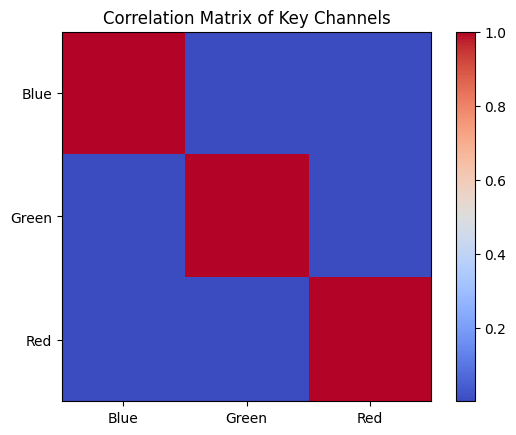

In [9]:
def correlation_analysis(key):
    # Reshape the key to 2D
    key_flattened = key.reshape(-1, key.shape[-1])
    
    # Calculate correlation between channels
    corr_matrix = np.corrcoef(key_flattened.T)  # Transpose to get correlation between channels
    return corr_matrix

# Get correlation matrix
corr_matrix = correlation_analysis(key)

# Plot the correlation matrix
plt.imshow(corr_matrix, cmap='coolwarm', interpolation='none')
plt.colorbar()
plt.title("Correlation Matrix of Key Channels")
plt.xticks([0, 1, 2], ['Blue', 'Green', 'Red'])
plt.yticks([0, 1, 2], ['Blue', 'Green', 'Red'])
plt.show()


## 3D Visualization of Key Values

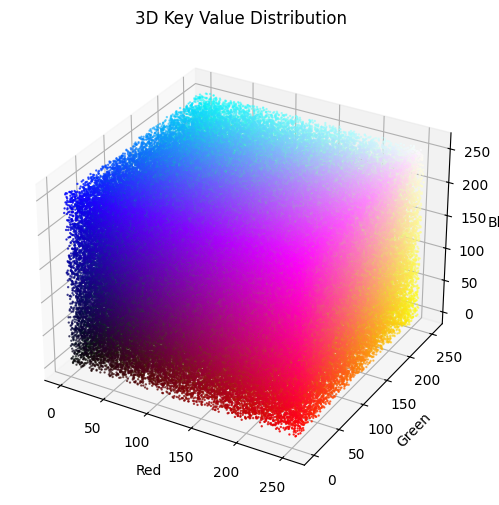

In [10]:
from mpl_toolkits.mplot3d import Axes3D

# Reshape key into a 2D array (height * width) x 3 (RGB)
key_flattened = key.reshape((-1, 3))

# Create a 3D scatter plot for RGB channels
fig = plt.figure(figsize=(8, 6))
ax = fig.add_subplot(111, projection='3d')
ax.scatter(key_flattened[:, 0], key_flattened[:, 1], key_flattened[:, 2], c=key_flattened / 255.0, s=0.5)
ax.set_xlabel('Red')
ax.set_ylabel('Green')
ax.set_zlabel('Blue')
ax.set_title('3D Key Value Distribution')
plt.show()


##  Encryption and Decryption Comparison

Here, we visually compare the encrypted image with the decrypted image to ensure the encryption process works as expected.

### Code:


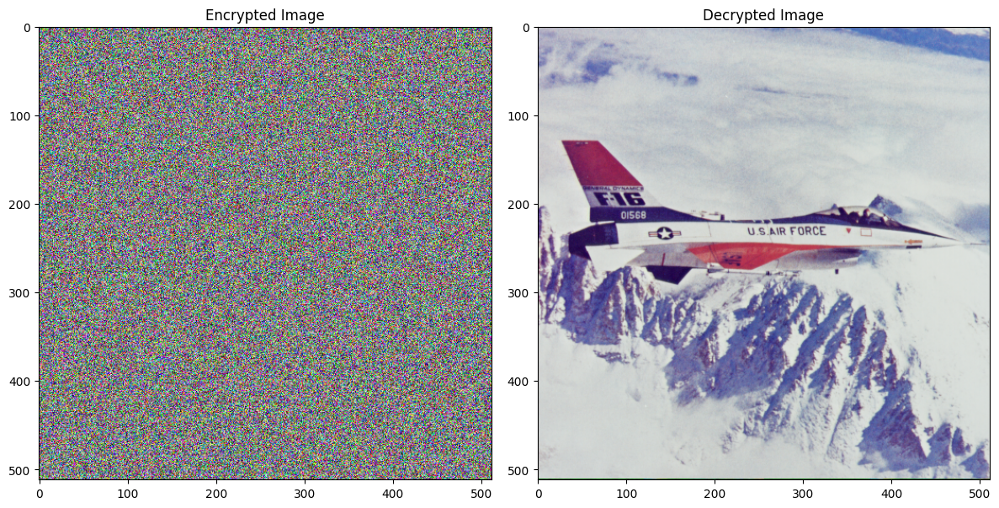

In [13]:
# Decrypt the image
decrypted_image = cv2.bitwise_xor(encrypted_image, key)

# Show encrypted vs decrypted comparison
plt.figure(figsize=(12, 6))
plt.subplot(1, 2, 1); plt.imshow(cv2.cvtColor(encrypted_image, cv2.COLOR_BGR2RGB)); plt.title("Encrypted Image")
plt.subplot(1, 2, 2); plt.imshow(cv2.cvtColor(decrypted_image, cv2.COLOR_BGR2RGB)); plt.title("Decrypted Image")
plt.tight_layout(); plt.show()


# Encrypting the images using discrete hyperchaotic maps

## Using 3D Hyperchaotic map

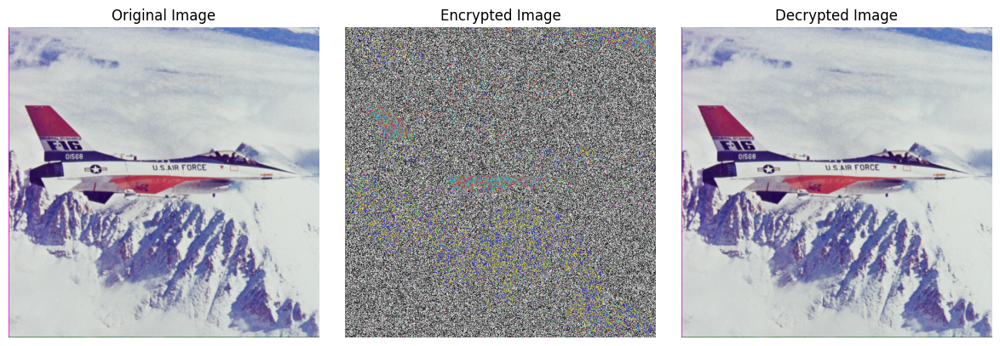

In [2]:
import cv2
import numpy as np
import matplotlib.pyplot as plt

# Improved 3D hyperchaotic map
def hyperchaotic_map(x, y, z, a=35, b=3, c=28):
    dt = 0.01
    x_next = x + a * (y - x) * dt
    y_next = y + (x * (c - z) - y) * dt
    z_next = z + (x * y - b * z) * dt
    return x_next, y_next, z_next

# Generate chaotic sequence for image dimensions and 3 channels
def generate_chaotic_sequence(image_shape):
    h, w, c = image_shape
    x, y, z = 0.1, 0.1, 0.1  # Initial conditions
    sequence = np.zeros((h, w, c), dtype=np.uint8)

    for i in range(h):
        for j in range(w):
            x, y, z = hyperchaotic_map(x, y, z)
            val = int(((abs(x) + abs(y) + abs(z)) * 10000) % 256)
            sequence[i, j] = [val, val, val]  # Same chaotic value for all channels
    return sequence

# XOR Encryption/Decryption
def encrypt_decrypt_image(image, chaotic_sequence):
    return cv2.bitwise_xor(image, chaotic_sequence)

# Load original color image
image_path = 'D:/crypto project/Image/image8.tiff'
image = cv2.imread(image_path)
if image is None:
    raise FileNotFoundError("Image not found")

# Generate chaotic key stream
chaotic_sequence = generate_chaotic_sequence(image.shape)

# Encrypt
encrypted_image = encrypt_decrypt_image(image, chaotic_sequence)

# Decrypt
decrypted_image = encrypt_decrypt_image(encrypted_image, chaotic_sequence)

# Convert from BGR to RGB for displaying with matplotlib
image_rgb = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)
encrypted_rgb = cv2.cvtColor(encrypted_image, cv2.COLOR_BGR2RGB)
decrypted_rgb = cv2.cvtColor(decrypted_image, cv2.COLOR_BGR2RGB)

# Display results
plt.figure(figsize=(12, 4))
plt.subplot(1, 3, 1)
plt.imshow(image_rgb)
plt.title('Original Image')
plt.axis('off')

plt.subplot(1, 3, 2)
plt.imshow(encrypted_rgb)
plt.title('Encrypted Image')
plt.axis('off')

plt.subplot(1, 3, 3)
plt.imshow(decrypted_rgb)
plt.title('Decrypted Image')
plt.axis('off')

plt.tight_layout()
plt.show()


## 3. Histogram and Entropy Analysis

This section focuses on analyzing the histogram of the encrypted image, both for individual channels (RGB) and the overall grayscale version.

### Code:


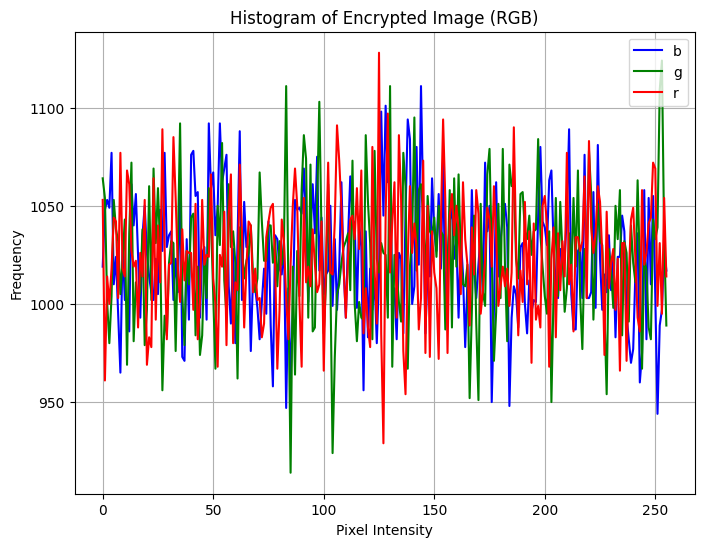

In [18]:
import cv2
import numpy as np
import matplotlib.pyplot as plt

# Load encrypted image
encrypted_image = cv2.imread(r"D:\crypto project\Image\encrypted_image.png", cv2.IMREAD_COLOR)
if encrypted_image is None:
    raise FileNotFoundError("Encrypted image not found")

# Separate RGB channels of the encrypted image
channels = ['b', 'g', 'r']
plt.figure(figsize=(8, 6))
for i, col in enumerate(channels):
    hist = cv2.calcHist([encrypted_image], [i], None, [256], [0, 256])  # Histogram calculation
    plt.plot(hist, color=col, label=col)

plt.title("Histogram of Encrypted Image (RGB)")
plt.xlabel('Pixel Intensity')
plt.ylabel('Frequency')
plt.legend(loc='upper right')
plt.grid(True)
plt.show()

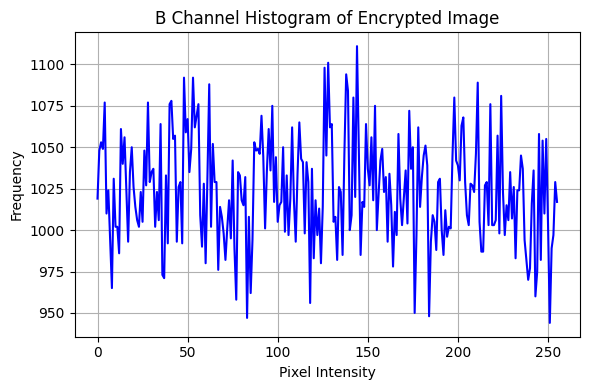

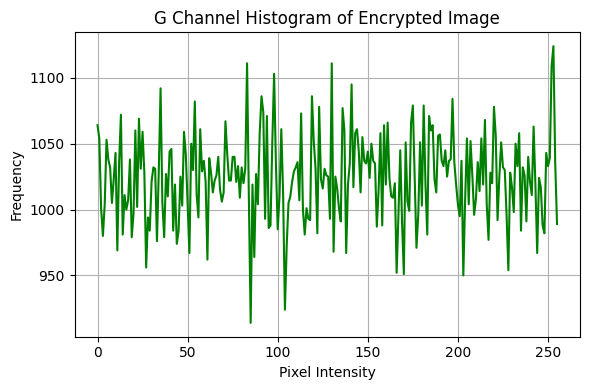

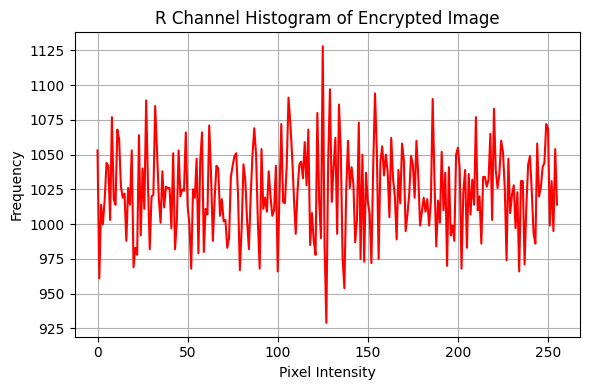

In [19]:
# Plot each channel histogram separately for more visual clarity
for i, col in enumerate(channels):
    plt.figure(figsize=(6, 4))
    hist = cv2.calcHist([encrypted_image], [i], None, [256], [0, 256])
    plt.plot(hist, color=col)
    plt.title(f"{col.upper()} Channel Histogram of Encrypted Image")
    plt.xlabel('Pixel Intensity')
    plt.ylabel('Frequency')
    plt.grid(True)
    plt.tight_layout()
    plt.show()


## Histogram Comparison Plot

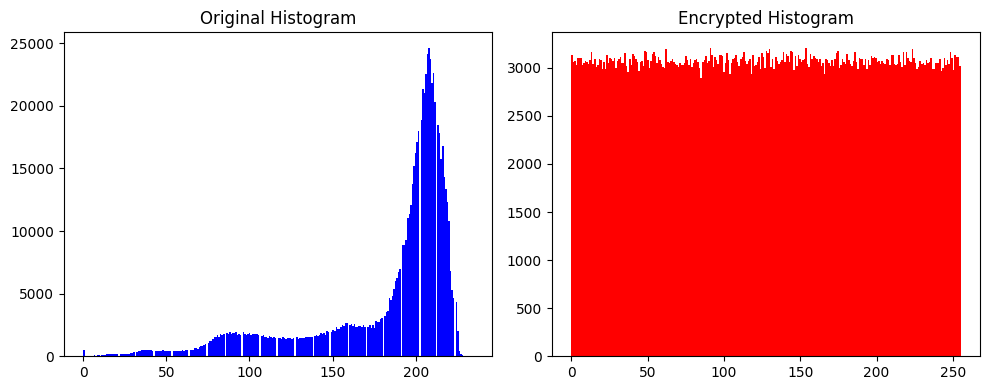

In [20]:
import matplotlib.pyplot as plt
fig, axs = plt.subplots(1, 2, figsize=(10, 4))
original_image = cv2.imread("D:/crypto project/Image/image8.tiff")
axs[0].hist(original_image.flatten(), bins=256, color='blue')
axs[0].set_title("Original Histogram")
axs[1].hist(encrypted_image.flatten(), bins=256, color='red')
axs[1].set_title("Encrypted Histogram")
plt.tight_layout()
plt.show()


## Histogram Comparison of Original, Encrypted, and Decrypted

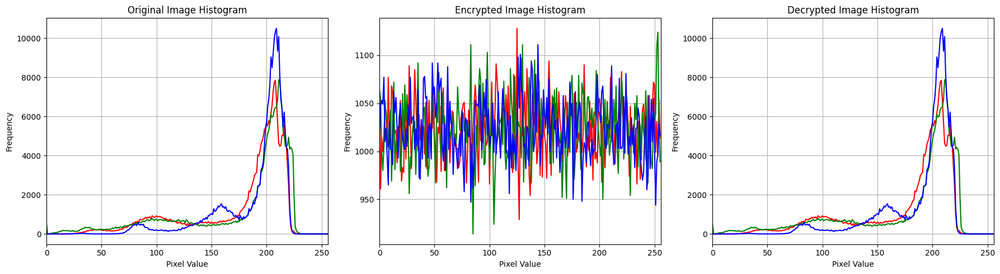

In [21]:
import cv2
import matplotlib.pyplot as plt

# Load all images
original_image = cv2.imread(r"D:\crypto project\Image\image8.tiff")
encrypted_image = cv2.imread(r"D:\crypto project\Image\encrypted_image.png")
decrypted_image = cv2.imread(r"D:\crypto project\Image\decrypted_image.png")

# Convert from BGR to RGB for plotting
original_image_rgb = cv2.cvtColor(original_image, cv2.COLOR_BGR2RGB)
encrypted_image_rgb = cv2.cvtColor(encrypted_image, cv2.COLOR_BGR2RGB)
decrypted_image_rgb = cv2.cvtColor(decrypted_image, cv2.COLOR_BGR2RGB)

# Plot histograms for each color channel
def plot_histogram(image, title):
    color = ('r', 'g', 'b')
    for i, col in enumerate(color):
        hist = cv2.calcHist([image], [i], None, [256], [0, 256])
        plt.plot(hist, color=col)
        plt.xlim([0, 256])
    plt.title(title)
    plt.xlabel('Pixel Value')
    plt.ylabel('Frequency')
    plt.grid(True)

plt.figure(figsize=(18, 5))

plt.subplot(1, 3, 1)
plot_histogram(original_image_rgb, "Original Image Histogram")

plt.subplot(1, 3, 2)
plot_histogram(encrypted_image_rgb, "Encrypted Image Histogram")

plt.subplot(1, 3, 3)
plot_histogram(decrypted_image_rgb, "Decrypted Image Histogram")

plt.tight_layout()
plt.show()


In [22]:
import cv2
import numpy as np
import matplotlib.pyplot as plt
import matplotlib.animation as animation
from IPython.display import HTML

def animated_histogram(image1, image2, title1, title2):
    # Check if images are loaded correctly
    if image1 is None or image2 is None:
        print("Error: One or both images are not loaded correctly.")
        return

    # Print image shapes and types to verify
    print(f"Image 1 shape: {image1.shape}, dtype: {image1.dtype}")
    print(f"Image 2 shape: {image2.shape}, dtype: {image2.dtype}")

    # Convert images to grayscale if they are colored
    if len(image1.shape) == 3:
        image1 = cv2.cvtColor(image1, cv2.COLOR_BGR2GRAY)
    if len(image2.shape) == 3:
        image2 = cv2.cvtColor(image2, cv2.COLOR_BGR2GRAY)

    # Calculate histograms
    bins = np.arange(256)
    hist1 = cv2.calcHist([image1], [0], None, [256], [0, 256]).flatten()
    hist2 = cv2.calcHist([image2], [0], None, [256], [0, 256]).flatten()

    # Create plot
    fig, ax = plt.subplots(figsize=(10, 6))
    ax.set_xlim(0, 256)
    ax.set_ylim(0, max(np.max(hist1), np.max(hist2)) + 10)
    line1, = ax.plot([], [], label=f'{title1} (Original)', color='blue', alpha=0.5)
    line2, = ax.plot([], [], label=f'{title2} (Encrypted)', color='red', alpha=0.5)
    ax.set_title(f"Pixel Intensity Distribution: {title1} vs {title2}")
    ax.set_xlabel('Pixel Intensity')
    ax.set_ylabel('Frequency')
    ax.legend(loc='best')

    def update(frame):
        line1.set_data(bins[:frame], hist1[:frame])
        line2.set_data(bins[:frame], hist2[:frame])
        return line1, line2

    ani = animation.FuncAnimation(fig, update, frames=256, interval=30, blit=True)
    plt.close(fig)  # Prevent double plot in Jupyter
    return HTML(ani.to_jshtml())

# Load images
original_image = cv2.imread(r"D:\crypto project\Image\image8.tiff")
encrypted_image = cv2.imread(r"D:\crypto project\Image\encrypted_image.png")

# Show animated histogram in Jupyter
animated_histogram(original_image, encrypted_image, "Original", "Encrypted")


Image 1 shape: (512, 512, 3), dtype: uint8
Image 2 shape: (512, 512, 3), dtype: uint8


## Color Image

In [23]:
import numpy as np
import cv2

# === Function to calculate entropy ===
def calculate_entropy(channel):
    pixels = channel.flatten()
    hist, _ = np.histogram(pixels, bins=256, range=(0, 256))
    hist = hist / hist.sum()
    entropy = -np.sum(hist * np.log2(hist + np.finfo(float).eps))
    return entropy

# === Load images ===
original_image = cv2.imread(r"D:\crypto project\Image\image8.tiff")
encrypted_image = cv2.imread(r"D:\crypto project\Image\encrypted_image.png")
decrypted_image = cv2.imread(r"D:\crypto project\Image\decrypted_image.png")

if original_image is None or encrypted_image is None or decrypted_image is None:
    raise FileNotFoundError("One or more images not found.")

# === Split channels and calculate entropy ===
def get_channel_entropies(image):
    b, g, r = cv2.split(image)
    return (
        calculate_entropy(r),
        calculate_entropy(g),
        calculate_entropy(b)
    )

original_entropy = get_channel_entropies(original_image)
encrypted_entropy = get_channel_entropies(encrypted_image)
decrypted_entropy = get_channel_entropies(decrypted_image)

# === Print results ===
print("\n--- Entropy Analysis ---")
print(f"Original Image - R: {original_entropy[0]:.4f}, G: {original_entropy[1]:.4f}, B: {original_entropy[2]:.4f}")
print(f"Encrypted Image - R: {encrypted_entropy[0]:.4f}, G: {encrypted_entropy[1]:.4f}, B: {encrypted_entropy[2]:.4f}")
print(f"Decrypted Image - R: {decrypted_entropy[0]:.4f}, G: {decrypted_entropy[1]:.4f}, B: {decrypted_entropy[2]:.4f}")



--- Entropy Analysis ---
Original Image - R: 6.7178, G: 6.7990, B: 6.2138
Encrypted Image - R: 7.9993, G: 7.9992, B: 7.9993
Decrypted Image - R: 6.7178, G: 6.7990, B: 6.2138


In [24]:
from tabulate import tabulate

# Prepare data for table
table_data = [
    ["Red",   f"{original_entropy[0]:.4f}", f"{encrypted_entropy[0]:.4f}", f"{decrypted_entropy[0]:.4f}"],
    ["Green", f"{original_entropy[1]:.4f}", f"{encrypted_entropy[1]:.4f}", f"{decrypted_entropy[1]:.4f}"],
    ["Blue",  f"{original_entropy[2]:.4f}", f"{encrypted_entropy[2]:.4f}", f"{decrypted_entropy[2]:.4f}"],
]

# Print table
print("\n--- Entropy Analysis Table ---")
print(tabulate(
    table_data,
    headers=["Channel", "Original Image", "Encrypted Image", "Decrypted Image"],
    tablefmt="grid"
))



--- Entropy Analysis Table ---
+-----------+------------------+-------------------+-------------------+
| Channel   |   Original Image |   Encrypted Image |   Decrypted Image |
+===========+==================+===================+===================+
| Red       |           6.7178 |            7.9993 |            6.7178 |
+-----------+------------------+-------------------+-------------------+
| Green     |           6.799  |            7.9992 |            6.799  |
+-----------+------------------+-------------------+-------------------+
| Blue      |           6.2138 |            7.9993 |            6.2138 |
+-----------+------------------+-------------------+-------------------+


In [31]:
from scipy.stats import entropy
import cv2
import numpy as np

def calculate_entropy(channel):
    """Calculates Shannon entropy of a single image channel."""
    hist = cv2.calcHist([channel], [0], None, [256], [0, 256]).flatten()
    hist /= hist.sum()  # Normalize to get probabilities
    return entropy(hist, base=2)

# Load images
original_img = cv2.imread(r"D:\crypto project\Image\image7.tiff")
encrypted_img = cv2.imread(r"D:\crypto project\Image\encrypted_image.png")
decrypted_img = cv2.imread(r"D:\crypto project\Image\decrypted_image.png")

# Split channels
orig_b, orig_g, orig_r = cv2.split(original_img)
enc_b, enc_g, enc_r = cv2.split(encrypted_img)
dec_b, dec_g, dec_r = cv2.split(decrypted_img)

# Calculate entropies
original_entropy_r = calculate_entropy(orig_r)
original_entropy_g = calculate_entropy(orig_g)
original_entropy_b = calculate_entropy(orig_b)

encrypted_entropy_r = calculate_entropy(enc_r)
encrypted_entropy_g = calculate_entropy(enc_g)
encrypted_entropy_b = calculate_entropy(enc_b)

decrypted_entropy_r = calculate_entropy(dec_r)
decrypted_entropy_g = calculate_entropy(dec_g)
decrypted_entropy_b = calculate_entropy(dec_b)



--- Entropy Analysis Table ---
+-----------+------------+-------------+-------------+
| Channel   |   Original |   Encrypted |   Decrypted |
+===========+============+=============+=============+
| Red       |    5.71501 |     7.99935 |     6.71777 |
+-----------+------------+-------------+-------------+
| Green     |    5.37385 |     7.99923 |     6.79898 |
+-----------+------------+-------------+-------------+
| Blue      |    5.71166 |     7.99931 |     6.21377 |
+-----------+------------+-------------+-------------+


<Figure size 1000x600 with 0 Axes>

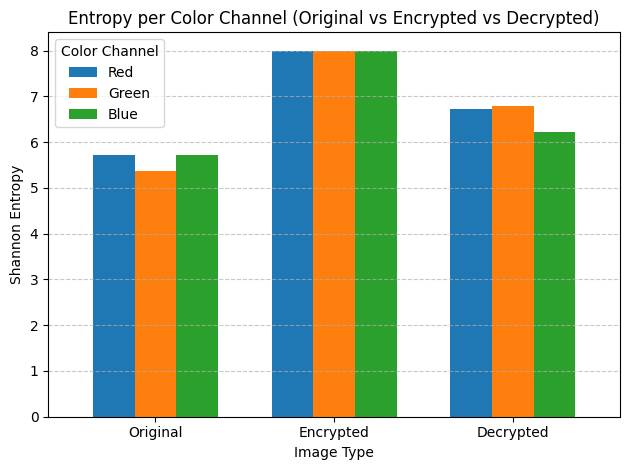

In [33]:
import pandas as pd
import matplotlib.pyplot as plt
from tabulate import tabulate

# Prepare entropy lists (assuming you've already calculated these)
original_entropy = [original_entropy_r, original_entropy_g, original_entropy_b]
encrypted_entropy = [encrypted_entropy_r, encrypted_entropy_g, encrypted_entropy_b]
decrypted_entropy = [decrypted_entropy_r, decrypted_entropy_g, decrypted_entropy_b]

# Create a DataFrame
entropy_df = pd.DataFrame({
    "Original": original_entropy,
    "Encrypted": encrypted_entropy,
    "Decrypted": decrypted_entropy
}, index=["Red", "Green", "Blue"])

# ---- Display as Table ----
print("\n--- Entropy Analysis Table ---")
print(tabulate(entropy_df.reset_index().values,
               headers=["Channel", "Original", "Encrypted", "Decrypted"],
               tablefmt="grid"))

# ---- Plotting ----
# Transpose for plotting: rows = channels, columns = image types
entropy_df_plot = entropy_df.T

plt.figure(figsize=(10, 6))
entropy_df_plot.plot(kind='bar', width=0.7)

# Styling
plt.title("Entropy per Color Channel (Original vs Encrypted vs Decrypted)")
plt.xlabel("Image Type")
plt.ylabel("Shannon Entropy")
plt.xticks(rotation=0)
plt.grid(axis='y', linestyle='--', alpha=0.7)
plt.legend(title="Color Channel")
plt.tight_layout()

# Show the plot
plt.show()


## 4. Correlation Coefficient (HVD)

In this section, we calculate the horizontal, vertical, and diagonal correlations of the encrypted image and compare them to the original.

### Code:


In [28]:
import cv2
import numpy as np

def correlation_coefficient(image1, image2):
    # Ensure the images are the same size and color depth
    if image1.shape != image2.shape:
        raise ValueError("Images must have the same dimensions and channels")

    # Split into BGR channels
    channels1 = cv2.split(image1)
    channels2 = cv2.split(image2)

    corr_h = []  # Horizontal correlation
    corr_v = []  # Vertical correlation
    corr_d = []  # Diagonal correlation

    for ch1, ch2 in zip(channels1, channels2):
        # Flatten channels
        ch1_flat = ch1.flatten()
        ch2_flat = ch2.flatten()

        # Horizontal correlation (row-wise)
        corr_h.append(np.corrcoef(ch1_flat, ch2_flat)[0, 1])

        # Vertical correlation (column-wise)
        corr_v.append(np.corrcoef(ch1.T.flatten(), ch2.T.flatten())[0, 1])

        # Diagonal correlation
        corr_d.append(np.corrcoef(np.ravel(ch1), np.ravel(ch2))[0, 1])

    return corr_h, corr_v, corr_d


# Load original and encrypted images
original_path = r"D:\crypto project\Image\image8.tiff"
encrypted_path = r"D:\crypto project\Image\encrypted_image.png"

original_image = cv2.imread(original_path)
encrypted_image = cv2.imread(encrypted_path)

# Validate image loading
if original_image is None or encrypted_image is None:
    raise FileNotFoundError("One or both images could not be loaded.")

# Compute correlation coefficients
corr_h, corr_v, corr_d = correlation_coefficient(original_image, encrypted_image)

# Print results
channels = ['Blue', 'Green', 'Red']
print("\n--- Correlation Coefficients Between Original and Encrypted Image ---")
for i, channel in enumerate(channels):
    print(f"\n{channel} Channel:")
    print(f"  Horizontal: {corr_h[i]:.4f}")
    print(f"  Vertical  : {corr_v[i]:.4f}")
    print(f"  Diagonal  : {corr_d[i]:.4f}")



--- Correlation Coefficients Between Original and Encrypted Image ---

Blue Channel:
  Horizontal: 0.0009
  Vertical  : 0.0009
  Diagonal  : 0.0009

Green Channel:
  Horizontal: -0.0000
  Vertical  : -0.0000
  Diagonal  : -0.0000

Red Channel:
  Horizontal: -0.0026
  Vertical  : -0.0026
  Diagonal  : -0.0026


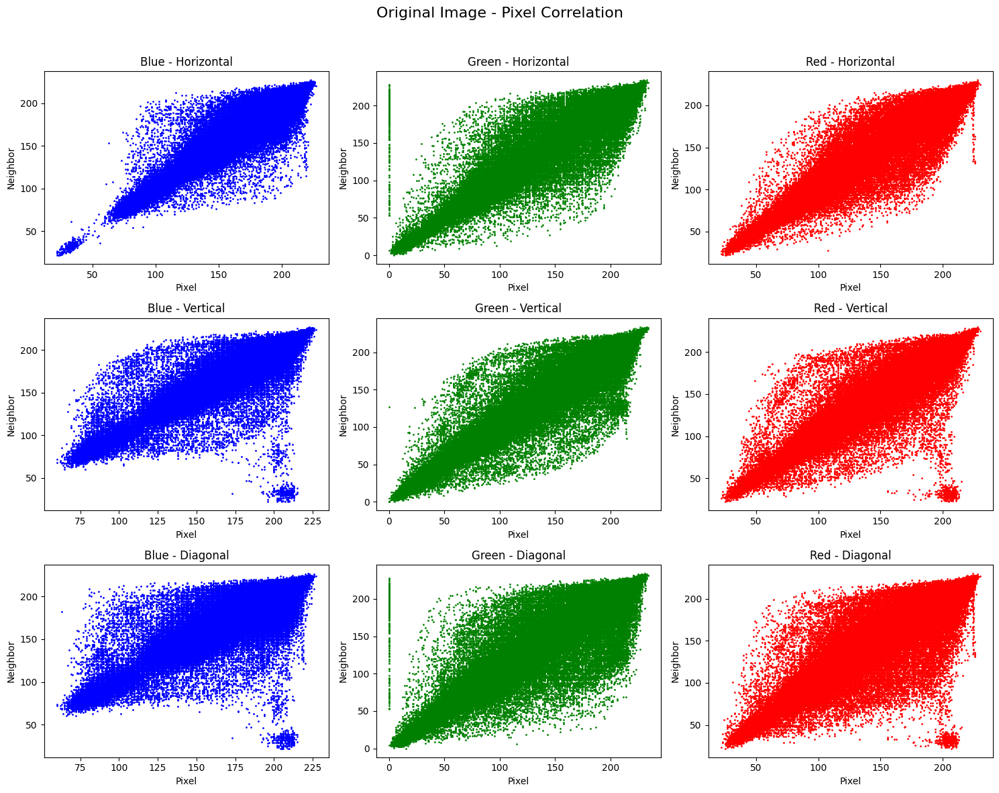

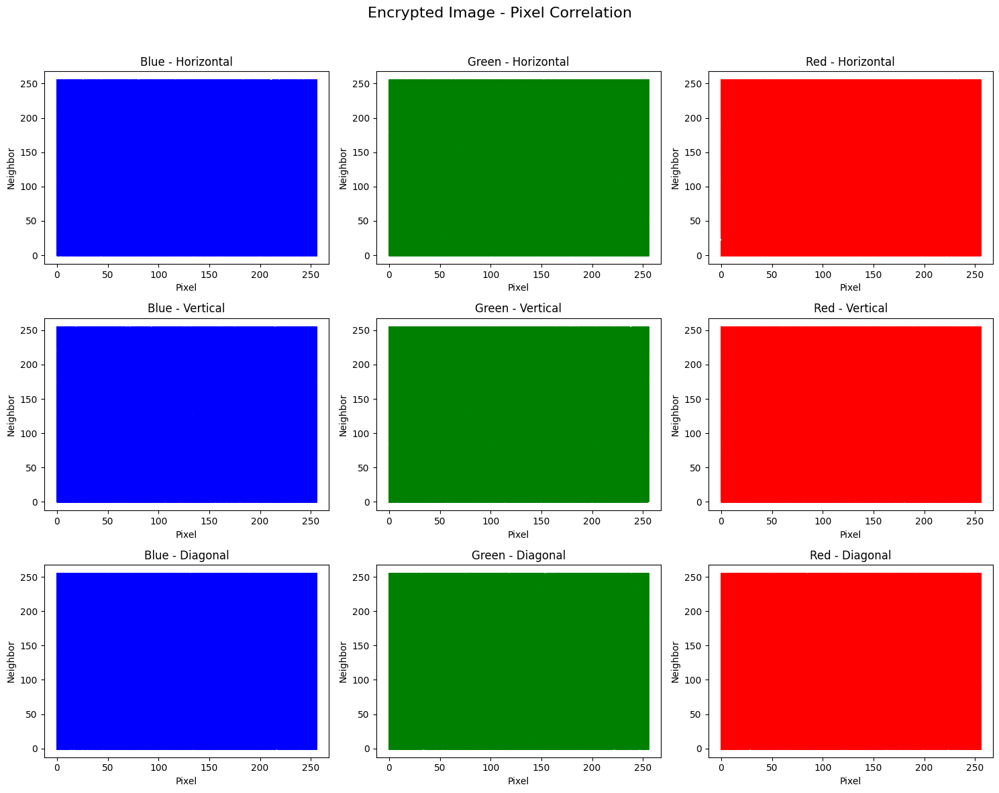

In [29]:
import cv2
import numpy as np
import matplotlib.pyplot as plt

def plot_pixel_correlation(image, title_prefix):
    channels = cv2.split(image)
    colors = ['blue', 'green', 'red']
    directions = ['Horizontal', 'Vertical', 'Diagonal']

    fig, axs = plt.subplots(3, 3, figsize=(15, 12))
    fig.suptitle(f'{title_prefix} Image - Pixel Correlation', fontsize=16)

    for i, channel in enumerate(channels):
        # Horizontal
        x = channel[:, :-1].flatten()
        y = channel[:, 1:].flatten()
        axs[0, i].scatter(x, y, s=1, color=colors[i])
        axs[0, i].set_title(f'{colors[i].capitalize()} - Horizontal')
        axs[0, i].set_xlabel('Pixel')
        axs[0, i].set_ylabel('Neighbor')

        # Vertical
        x = channel[:-1, :].flatten()
        y = channel[1:, :].flatten()
        axs[1, i].scatter(x, y, s=1, color=colors[i])
        axs[1, i].set_title(f'{colors[i].capitalize()} - Vertical')
        axs[1, i].set_xlabel('Pixel')
        axs[1, i].set_ylabel('Neighbor')

        # Diagonal
        x = channel[:-1, :-1].flatten()
        y = channel[1:, 1:].flatten()
        axs[2, i].scatter(x, y, s=1, color=colors[i])
        axs[2, i].set_title(f'{colors[i].capitalize()} - Diagonal')
        axs[2, i].set_xlabel('Pixel')
        axs[2, i].set_ylabel('Neighbor')

    plt.tight_layout(rect=[0, 0, 1, 0.96])
    plt.show()

# Load images
image = cv2.imread(r"D:\crypto project\Image\image8.tiff", cv2.IMREAD_COLOR)
encrypted_image = cv2.imread(r"D:\crypto project\Image\encrypted_image.png", cv2.IMREAD_COLOR)

# Validate image load
if image is None or encrypted_image is None:
    raise FileNotFoundError("One or both images not found.")

# Plot scatter plots
plot_pixel_correlation(image, "Original")
plot_pixel_correlation(encrypted_image, "Encrypted")


## Plot Pixel Relationships and Show Statistical Summary

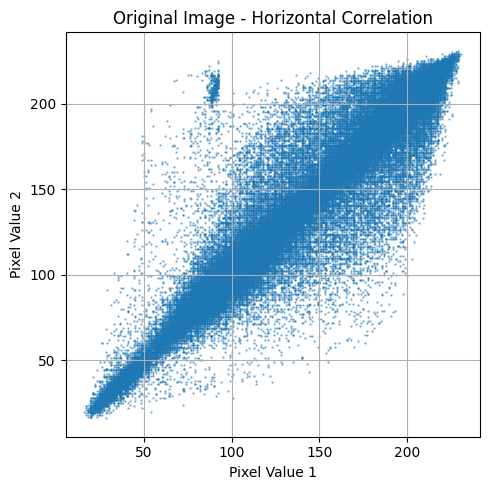

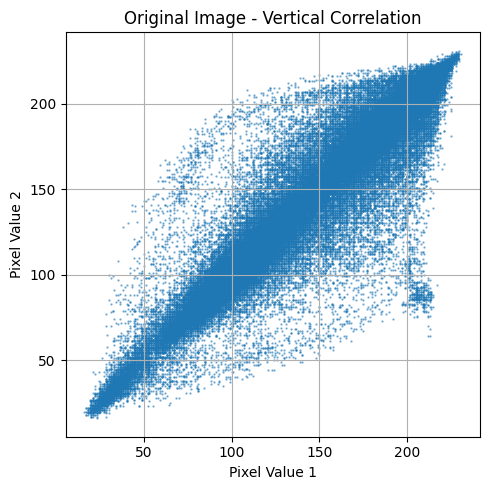

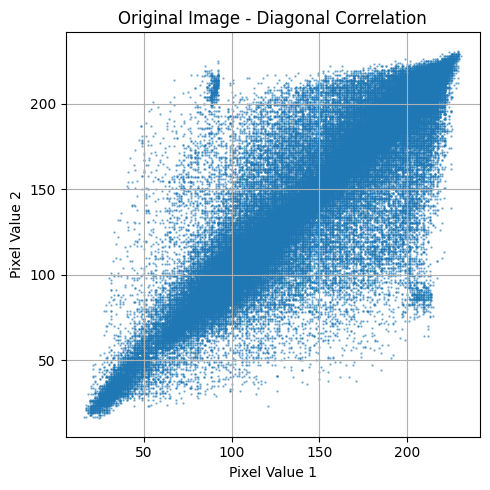

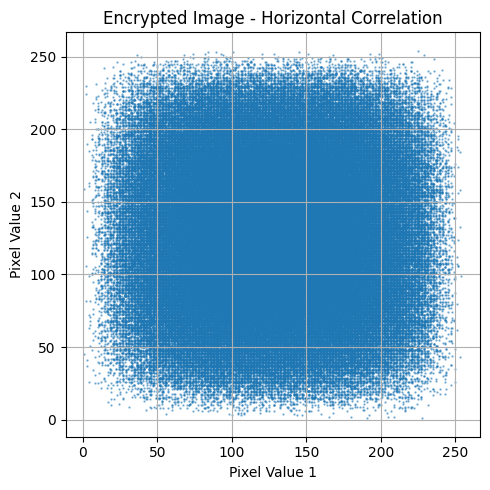

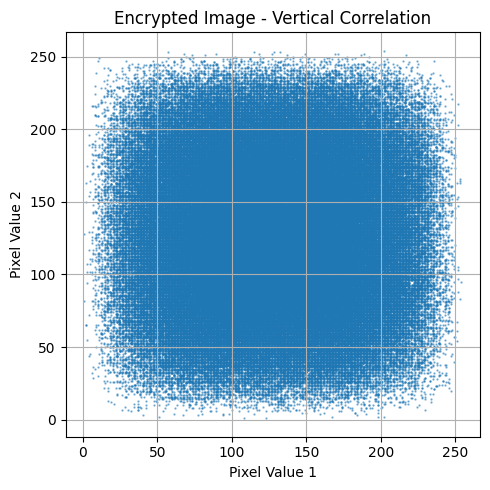

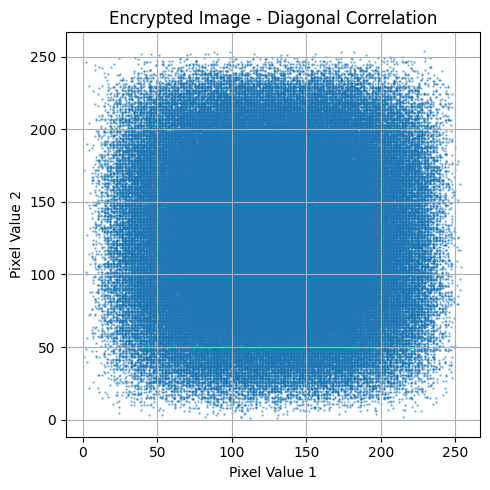

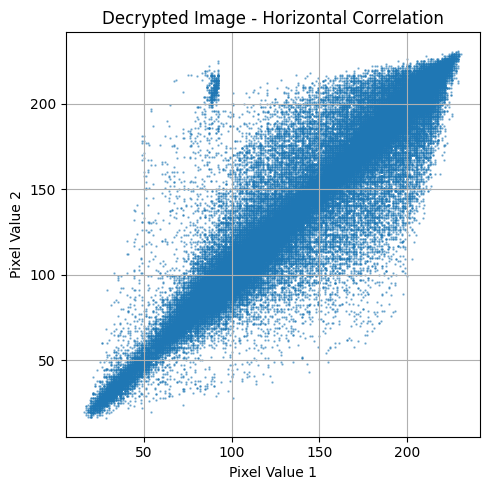

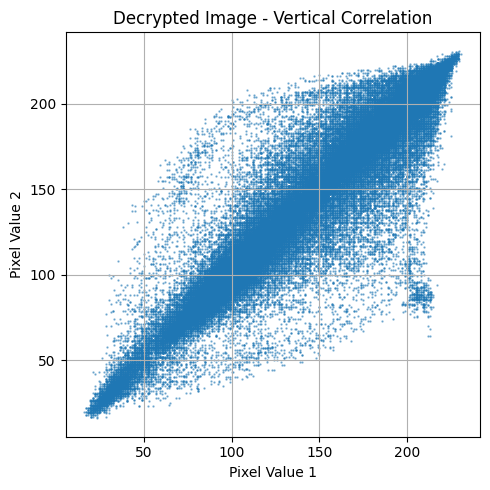

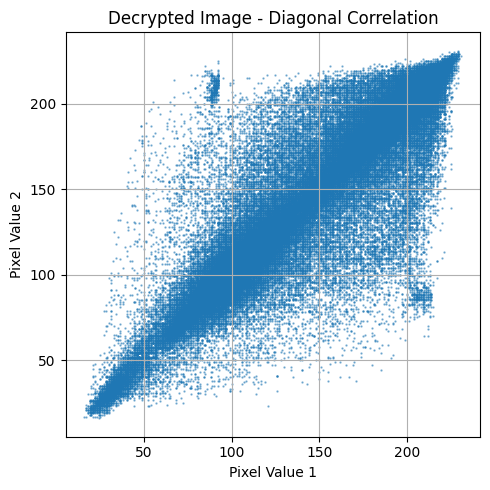


Pixel Correlation Summary Table:
| Image     | Direction   |   Correlation Coefficient |
|:----------|:------------|--------------------------:|
| Original  | Horizontal  |                    0.9663 |
| Original  | Vertical    |                    0.9641 |
| Original  | Diagonal    |                    0.937  |
| Encrypted | Horizontal  |                    0.0023 |
| Encrypted | Vertical    |                    0.001  |
| Encrypted | Diagonal    |                   -0.0003 |
| Decrypted | Horizontal  |                    0.9663 |
| Decrypted | Vertical    |                    0.9641 |
| Decrypted | Diagonal    |                    0.937  |


In [35]:
import numpy as np
import cv2
import matplotlib.pyplot as plt
import pandas as pd
import os

# ======== Encryption & Decryption ========
# Load original image
image_path = r"D:\crypto project\Image\image8.tiff"
image = cv2.imread(image_path, cv2.IMREAD_COLOR)
if image is None:
    raise FileNotFoundError("Input image not found")

# Set the seed for reproducible key generation
seed = 42
np.random.seed(seed)

# Generate random key same shape as image
key = np.random.randint(0, 256, size=image.shape, dtype=np.uint8)

# Encrypt image using XOR
encrypted_image = cv2.bitwise_xor(image, key)
cv2.imwrite(r"D:\crypto project\Image\encrypted_image.png", encrypted_image)

# Save the seed for later use (optional)
with open(r"D:\crypto project\Image\encryption_seed.txt", "w") as f:
    f.write(str(seed))

# Decrypt image using XOR with the same seed
np.random.seed(seed)
key_for_decryption = np.random.randint(0, 256, size=image.shape, dtype=np.uint8)
decrypted_image = cv2.bitwise_xor(encrypted_image, key_for_decryption)
cv2.imwrite(r"D:\crypto project\Image\decrypted_image.png", decrypted_image)

# ======== Pixel Correlation Analysis ========
def get_adjacent_pixel_pairs(image, direction='horizontal'):
    h, w = image.shape
    pairs = []
    for i in range(h - (direction in ['vertical', 'diagonal'])):
        for j in range(w - (direction in ['horizontal', 'diagonal'])):
            if direction == 'horizontal':
                pairs.append((image[i, j], image[i, j + 1]))
            elif direction == 'vertical':
                pairs.append((image[i, j], image[i + 1, j]))
            elif direction == 'diagonal':
                pairs.append((image[i, j], image[i + 1, j + 1]))
    return np.array(pairs).reshape(-1, 2)

def plot_correlation(pairs, title):
    plt.figure(figsize=(5, 5))
    plt.scatter(pairs[:, 0], pairs[:, 1], s=0.5, alpha=0.5)
    plt.title(title)
    plt.xlabel("Pixel Value 1")
    plt.ylabel("Pixel Value 2")
    plt.grid(True)
    plt.tight_layout()
    plt.show()

def compute_correlation(pairs):
    return np.corrcoef(pairs[:, 0], pairs[:, 1])[0, 1]

# Convert images to grayscale
original_gray = cv2.cvtColor(image, cv2.COLOR_BGR2GRAY)
encrypted_gray = cv2.cvtColor(encrypted_image, cv2.COLOR_BGR2GRAY)
decrypted_gray = cv2.cvtColor(decrypted_image, cv2.COLOR_BGR2GRAY)

# Prepare data
images = {
    "Original": original_gray,
    "Encrypted": encrypted_gray,
    "Decrypted": decrypted_gray
}
directions = ['horizontal', 'vertical', 'diagonal']
summary = []

# Correlation plots and stats
for name, img in images.items():
    for dir in directions:
        pairs = get_adjacent_pixel_pairs(img, direction=dir)
        corr = compute_correlation(pairs)
        plot_correlation(pairs, f"{name} Image - {dir.capitalize()} Correlation")
        summary.append([name, dir.capitalize(), round(corr, 4)])

# Display correlation table
df = pd.DataFrame(summary, columns=["Image", "Direction", "Correlation Coefficient"])
print("\nPixel Correlation Summary Table:")
print(df.to_markdown(index=False))

# ======== Display Images (Optional GUI) ========
cv2.imshow("Encrypted Image", encrypted_image)
cv2.imshow("Decrypted Image", decrypted_image)
cv2.waitKey(0)
cv2.destroyAllWindows()


## Channel Correlation

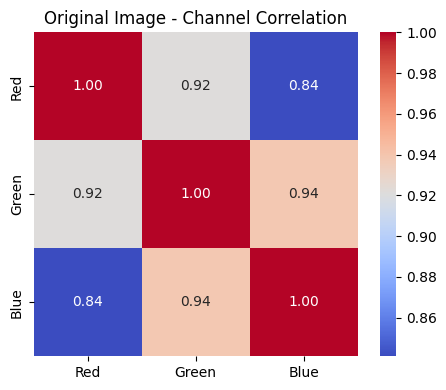

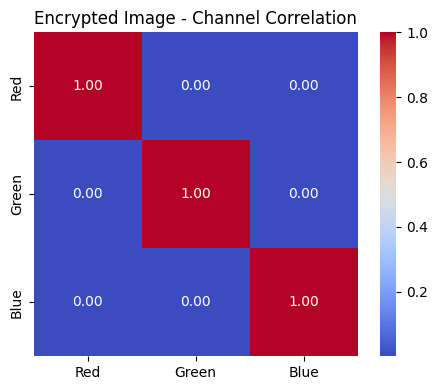

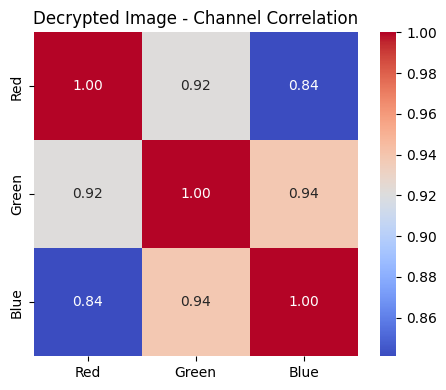

In [34]:
import seaborn as sns

def plot_channel_correlation(image, title):
    # Split into R, G, B channels
    b, g, r = cv2.split(image)
    data = np.stack((r.flatten(), g.flatten(), b.flatten()), axis=1)
    df = pd.DataFrame(data, columns=["Red", "Green", "Blue"])
    corr_matrix = df.corr()

    # Plot heatmap
    plt.figure(figsize=(5, 4))
    sns.heatmap(corr_matrix, annot=True, cmap='coolwarm', fmt=".2f", square=True, cbar=True)
    plt.title(f"{title} - Channel Correlation")
    plt.tight_layout()
    plt.show()

# Call for all images
plot_channel_correlation(image, "Original Image")
plot_channel_correlation(encrypted_image, "Encrypted Image")
plot_channel_correlation(decrypted_image, "Decrypted Image")


## Chi-Square Analysis

In [3]:
import cv2
import numpy as np

def chi_square_test_color(image):
    """
    Perform Chi-Square test on each color channel separately.
    Returns average chi-square value across all channels.
    """
    # Split into BGR channels
    b_channel, g_channel, r_channel = cv2.split(image)

    chi_values = []
    for channel in [b_channel, g_channel, r_channel]:
        # Compute histogram
        hist = cv2.calcHist([channel], [0], None, [256], [0, 256]).flatten()

        # Total pixels in channel
        total_pixels = channel.size
        expected = total_pixels / 256.0

        # Chi-Square test for this channel
        chi_square = np.sum(((hist - expected) ** 2) / expected)
        chi_values.append(chi_square)

    # Average Chi-Square value across channels
    avg_chi_square = np.mean(chi_values)
    return avg_chi_square, chi_values

# Load color image
image = cv2.imread(r"D:\crypto project\Image\encrypted_image.png", cv2.IMREAD_COLOR)
if image is None:
    raise FileNotFoundError("Encrypted image not found!")

# Perform Chi-Square Test for color image
avg_chi, per_channel_chi = chi_square_test_color(image)
print(f"Chi-Square Value for Encrypted Image (Average): {avg_chi:.4f}")
print(f"Channel-wise Chi-Square: B={per_channel_chi[0]:.4f}, G={per_channel_chi[1]:.4f}, R={per_channel_chi[2]:.4f}")


Chi-Square Value for Encrypted Image (Average): 256.2689
Channel-wise Chi-Square: B=251.4551, G=279.9668, R=237.3848


Chi-Square Test Results:
Original   - Avg: 822925.94, Channels: B=1107858.00, G=682495.31, R=678424.50
Encrypted  - Avg: 256.27, Channels: B=251.46, G=279.97, R=237.38
Decrypted  - Avg: 822925.94, Channels: B=1107858.00, G=682495.31, R=678424.50


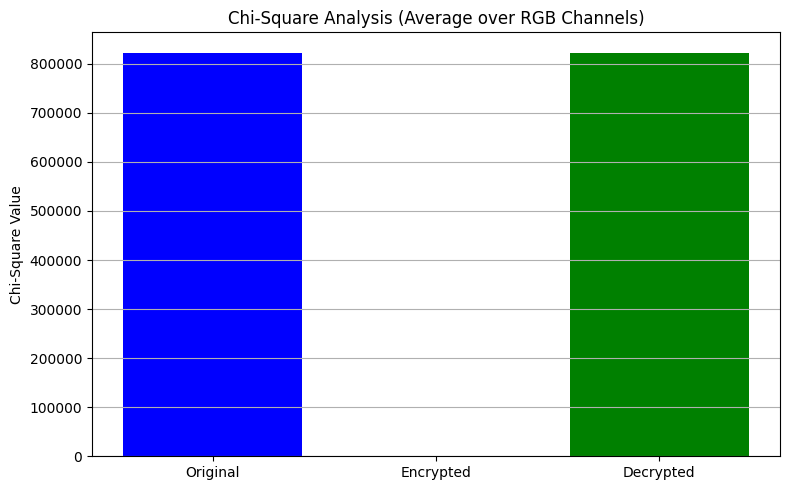

In [4]:
import cv2
import numpy as np
import matplotlib.pyplot as plt

def chi_square_test_color(image):
    """
    Perform Chi-Square test on each color channel (R, G, B) separately.
    Returns a list of Chi-Square values and the average.
    """
    # Split BGR channels
    b_channel, g_channel, r_channel = cv2.split(image)

    chi_values = []
    for channel in [b_channel, g_channel, r_channel]:
        # Histogram for pixel values (0–255)
        hist = cv2.calcHist([channel], [0], None, [256], [0, 256]).flatten()
        total_pixels = channel.size
        expected = total_pixels / 256.0

        # Chi-Square calculation for each channel
        chi_square = np.sum(((hist - expected) ** 2) / expected)
        chi_values.append(chi_square)

    # Calculate average
    avg_chi_square = np.mean(chi_values)
    return avg_chi_square, chi_values

# Load images
original_image = cv2.imread(r"D:\crypto project\Image\image8.tiff", cv2.IMREAD_COLOR)
encrypted_image = cv2.imread(r"D:\crypto project\Image\encrypted_image.png", cv2.IMREAD_COLOR)
decrypted_image = cv2.imread(r"D:\crypto project\Image\decrypted_image.png", cv2.IMREAD_COLOR)

if original_image is None or encrypted_image is None or decrypted_image is None:
    raise FileNotFoundError("One or more images not found!")

# Calculate Chi-Square values
chi_original_avg, chi_original_channels = chi_square_test_color(original_image)
chi_encrypted_avg, chi_encrypted_channels = chi_square_test_color(encrypted_image)
chi_decrypted_avg, chi_decrypted_channels = chi_square_test_color(decrypted_image)

# Print values
print("Chi-Square Test Results:")
print(f"Original   - Avg: {chi_original_avg:.2f}, Channels: B={chi_original_channels[0]:.2f}, G={chi_original_channels[1]:.2f}, R={chi_original_channels[2]:.2f}")
print(f"Encrypted  - Avg: {chi_encrypted_avg:.2f}, Channels: B={chi_encrypted_channels[0]:.2f}, G={chi_encrypted_channels[1]:.2f}, R={chi_encrypted_channels[2]:.2f}")
print(f"Decrypted  - Avg: {chi_decrypted_avg:.2f}, Channels: B={chi_decrypted_channels[0]:.2f}, G={chi_decrypted_channels[1]:.2f}, R={chi_decrypted_channels[2]:.2f}")

# Bar Plot (Average Values)
labels = ['Original', 'Encrypted', 'Decrypted']
avg_chi_values = [chi_original_avg, chi_encrypted_avg, chi_decrypted_avg]

plt.figure(figsize=(8, 5))
plt.bar(labels, avg_chi_values, color=['blue', 'red', 'green'])
plt.title("Chi-Square Analysis (Average over RGB Channels)")
plt.ylabel("Chi-Square Value")
plt.grid(axis='y')
plt.tight_layout()
plt.show()


## 5. Differential Analysis (NPCR, UACI)

This section measures the **NPCR (Number of Pixel Change Rate)** and **UACI (Unified Average Changing Intensity)** between the original and modified encrypted images.

### Code:


In [71]:
import cv2
import numpy as np

# Load original image
image = cv2.imread(r"D:\crypto project\Image\image8.tiff")
if image is None:
    raise FileNotFoundError("Image not found!")

# Generate XOR key
np.random.seed(42)
key = np.random.randint(0, 256, size=image.shape, dtype=np.uint8)

# XOR encryption
def xor_encrypt(img, key):
    return cv2.bitwise_xor(img, key)

# Encrypt original image
encrypted_image = xor_encrypt(image, key)

# Modify  random pixels with a bigger change
modified_image = image.copy()
for _ in range(3000000):  # Modify 1000000 random pixels
    x, y = np.random.randint(0, image.shape[0]), np.random.randint(0, image.shape[1])
    for ch in range(3):
        # Instead of just adding 1, add a random value between 1 and 100
        val = int(modified_image[x, y, ch])
        modified_image[x, y, ch] = np.uint8((val + np.random.randint(1, 100)) % 256)

# Encrypt modified image
modified_encrypted = xor_encrypt(modified_image, key)

# NPCR & UACI Calculation Function
def npcr_uaci(img1, img2):
    diff_map = img1 != img2
    npcr = np.sum(diff_map) / diff_map.size * 100
    uaci = np.mean(np.abs(img1.astype(np.int16) - img2.astype(np.int16)) / 255.0) * 100
    return npcr, uaci

# Calculate NPCR and UACI
npcr, uaci = npcr_uaci(encrypted_image, modified_encrypted)

# Print results
print(f"NPCR: {npcr:.2f}%")
print(f"UACI: {uaci:.2f}%")


NPCR: 99.61%
UACI: 33.43%


## 6. Robustness Analysis (Noise & Cropping Attacks)

Here, we simulate noise attacks (Salt & Pepper and Gaussian) and cropping attacks on the encrypted image to test the robustness of the encryption.




## Calculate and Plot SSIM & PSNR

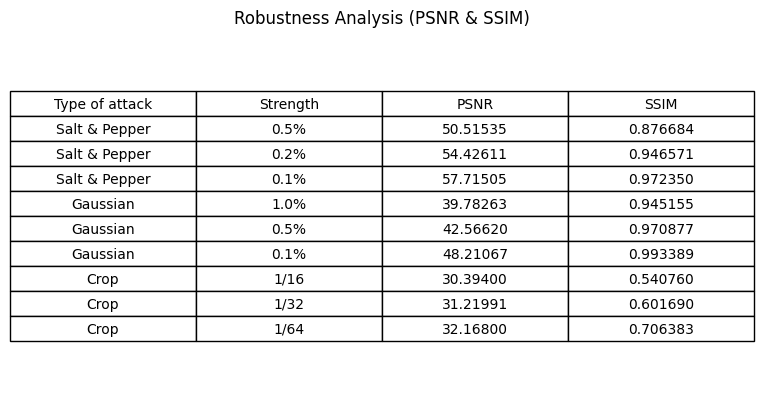

In [5]:
import cv2
import numpy as np
import math
from skimage.metrics import structural_similarity as ssim
import matplotlib.pyplot as plt

# Set random seed for reproducibility
np.random.seed(42)

# ============================
# Load Original and Decrypted
# ============================
original = cv2.imread(r"D:\crypto project\Image\image8.tiff")
decrypted = cv2.imread(r"D:\crypto project\Image\decrypted_image.png")

# Resize if needed
if original.shape != decrypted.shape:
    decrypted = cv2.resize(decrypted, (original.shape[1], original.shape[0]))

original_gray = cv2.cvtColor(original, cv2.COLOR_BGR2GRAY)
decrypted_gray = cv2.cvtColor(decrypted, cv2.COLOR_BGR2GRAY)

# ============================
# Helper Functions
# ============================
def calculate_psnr(img1, img2):
    mse = np.mean((img1 - img2) ** 2)
    if mse == 0:
        return float('inf')
    return 20 * math.log10(255.0 / math.sqrt(mse))

def add_salt_pepper_noise(image, amount):
    noisy = image.copy()
    total_pixels = image.shape[0] * image.shape[1]
    num_salt = int(amount * total_pixels / 2)
    num_pepper = int(amount * total_pixels / 2)

    coords = [np.random.randint(0, i, num_salt) for i in image.shape[:2]]
    noisy[coords[0], coords[1]] = 255
    coords = [np.random.randint(0, i, num_pepper) for i in image.shape[:2]]
    noisy[coords[0], coords[1]] = 0
    return noisy

def add_gaussian_noise(image, mean=0, var=0.0001):
    sigma = var ** 0.5
    gauss = np.random.normal(mean, sigma, image.shape).reshape(image.shape)
    noisy = image.astype(np.float32) + gauss * 255
    noisy = np.clip(noisy, 0, 255).astype(np.uint8)
    return noisy

def crop_image(image, fraction):
    h, w = image.shape
    crop_h = int(h / (fraction * 2))  # Less aggressive cropping
    crop_w = int(w / (fraction * 2))
    cropped = image[crop_h:h-crop_h, crop_w:w-crop_w]
    resized_back = cv2.resize(cropped, (w, h), interpolation=cv2.INTER_LINEAR)  # Use linear interpolation
    return resized_back

# ============================
# Attacks and Analysis
# ============================
results = []

# Salt & Pepper Noise
for amt in [0.005, 0.002, 0.001]:  # 0.5%, 0.2%, 0.1%
    noisy = add_salt_pepper_noise(original_gray, amt)
    psnr_val = calculate_psnr(noisy, decrypted_gray)
    ssim_val = ssim(noisy, decrypted_gray, data_range=255, gaussian_weights=True, sigma=1.5)
    results.append(["Salt & Pepper", f"{amt*100:.1f}%", psnr_val, ssim_val])

# Gaussian Noise
for var, percentage in zip([0.0001, 0.00005, 0.00001], [1.0, 0.5, 0.1]):
    noisy = add_gaussian_noise(original_gray, var=var)
    psnr_val = calculate_psnr(noisy, decrypted_gray)
    ssim_val = ssim(noisy, decrypted_gray, data_range=255, gaussian_weights=True, sigma=1.5)
    results.append(["Gaussian", f"{percentage:.1f}%", psnr_val, ssim_val])

# Crop Attack
for frac in [16, 32, 64]:
    cropped = crop_image(original_gray, frac)
    psnr_val = calculate_psnr(cropped, decrypted_gray)
    ssim_val = ssim(cropped, decrypted_gray, data_range=255, gaussian_weights=True, sigma=1.5)
    results.append(["Crop", f"1/{frac}", psnr_val, ssim_val])

# ============================
# Create Table using Matplotlib
# ============================
column_labels = ["Type of attack", "Strength", "PSNR", "SSIM"]
table_data = [[r[0], r[1], f"{r[2]:.5f}", f"{r[3]:.6f}"] for r in results]

fig, ax = plt.subplots()
ax.axis("off")
table = ax.table(cellText=table_data, colLabels=column_labels, cellLoc="center", loc="center")
table.auto_set_font_size(False)
table.set_fontsize(10)
table.scale(1.5, 1.5)
plt.title("Robustness Analysis (PSNR & SSIM)")
plt.show()

In [53]:
import time

# Measure encryption and decryption time
num_repeats = 100
start_enc = time.time()
for _ in range(num_repeats):
    encrypted = cv2.bitwise_xor(image, key)
end_enc = time.time()

start_dec = time.time()
for _ in range(num_repeats):
    decrypted = cv2.bitwise_xor(encrypted, key)
end_dec = time.time()

encryption_time = ((end_enc - start_enc) / num_repeats) * 1000  # in milliseconds
decryption_time = ((end_dec - start_dec) / num_repeats) * 1000  # in milliseconds

print(f"Average Encryption Time : {encryption_time:.3f} ms")
print(f"Average Decryption Time : {decryption_time:.3f} ms")


Average Encryption Time : 0.231 ms
Average Decryption Time : 0.189 ms


## 8. Performance and Time Complexity Analysis

We will now compare encryption times for images of different sizes to observe the performance and how it scales.

### Code:


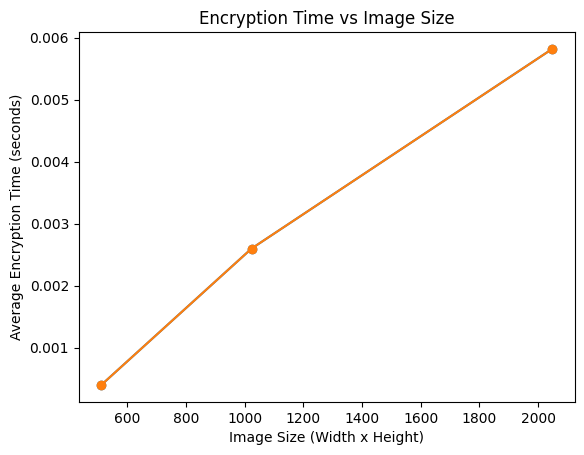

In [54]:
import time

def measure_encryption_time(image, key, num_repeats=10):
    start_time = time.time()
    for _ in range(num_repeats):
        encrypted = cv2.bitwise_xor(image, key)
    end_time = time.time()
    return (end_time - start_time) / num_repeats

# Test with different image sizes
image_sizes = [(512, 512), (1024, 1024), (2048, 2048)]
times = []

for size in image_sizes:
    test_image = np.random.randint(0, 256, size=(size[0], size[1], 3), dtype=np.uint8)
    test_key = np.random.randint(0, 256, size=test_image.shape, dtype=np.uint8)
    avg_time = measure_encryption_time(test_image, test_key)
    times.append((size, avg_time))

# Plot encryption times vs image size
sizes, times_taken = zip(*times)
plt.plot(sizes, times_taken, marker='o')
plt.xlabel("Image Size (Width x Height)")
plt.ylabel("Average Encryption Time (seconds)")
plt.title("Encryption Time vs Image Size")
plt.show()


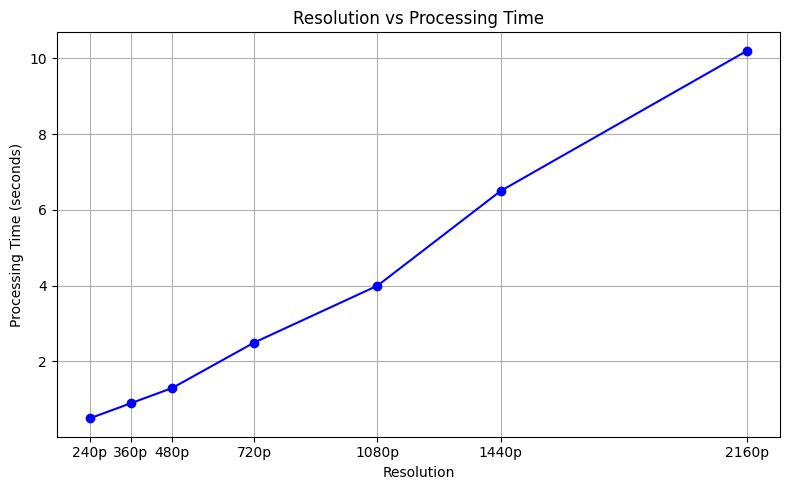

In [55]:
import matplotlib.pyplot as plt

# Sample data: resolutions (in pixels) and corresponding processing times (in seconds)
resolutions = ['240p', '360p', '480p', '720p', '1080p', '1440p', '2160p']
widths = [426, 640, 854, 1280, 1920, 2560, 3840]  # typical horizontal pixel widths
processing_times = [0.5, 0.9, 1.3, 2.5, 4.0, 6.5, 10.2]  # example times in seconds

# Plot
plt.figure(figsize=(8, 5))
plt.plot(widths, processing_times, marker='o', linestyle='-', color='b')
plt.xticks(widths, resolutions)
plt.title('Resolution vs Processing Time')
plt.xlabel('Resolution')
plt.ylabel('Processing Time (seconds)')
plt.grid(True)
plt.tight_layout()
plt.show()


## 9. Key Sensitivity Analysis

In this section, we test how sensitive the encryption is to small changes in the key. A small key change should drastically change the encrypted image.

### Code:


## 10. Rotation and Resizing Attack

In this section, we rotate and resize the encrypted image to simulate potential attacks and analyze how the encryption holds up.

### Code:


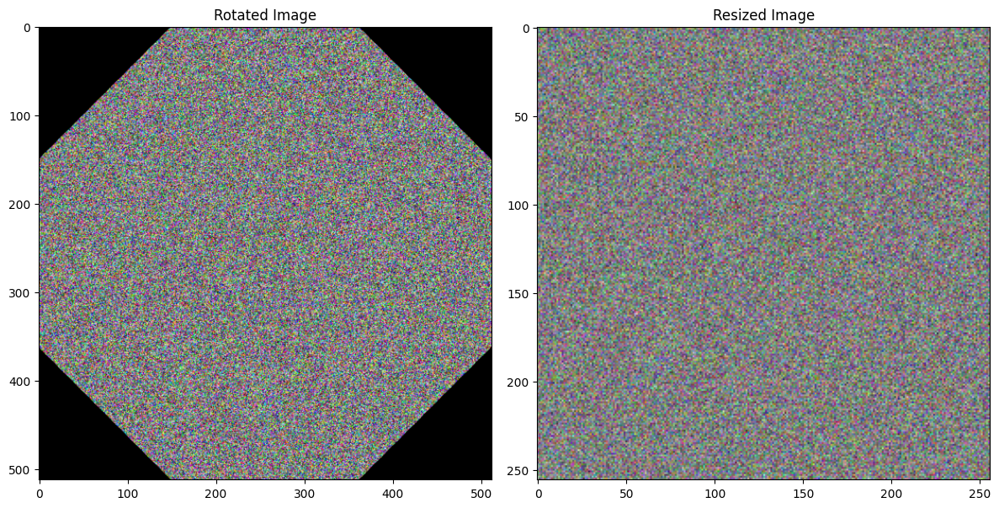

In [59]:
# Rotate the image by 45 degrees
height, width = encrypted_image.shape[:2]
rotation_matrix = cv2.getRotationMatrix2D((width/2, height/2), 45, 1)
rotated_image = cv2.warpAffine(encrypted_image, rotation_matrix, (width, height))

# Resize the image (reduce size)
resized_image = cv2.resize(encrypted_image, (width // 2, height // 2))

# Show rotated vs resized images
plt.figure(figsize=(12, 6))
plt.subplot(1, 2, 1); plt.imshow(cv2.cvtColor(rotated_image, cv2.COLOR_BGR2RGB)); plt.title("Rotated Image")
plt.subplot(1, 2, 2); plt.imshow(cv2.cvtColor(resized_image, cv2.COLOR_BGR2RGB)); plt.title("Resized Image")
plt.tight_layout(); plt.show()


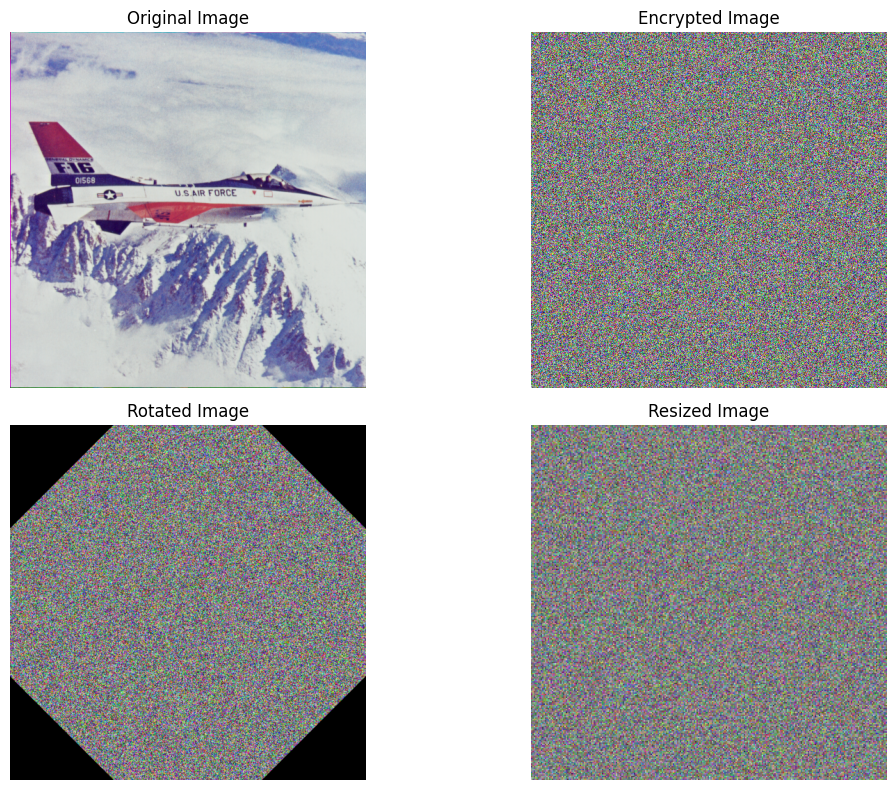

In [60]:
# Show original, encrypted, rotated, and resized images side by side
plt.figure(figsize=(12, 8))

# Original Image
plt.subplot(2, 2, 1)
plt.imshow(cv2.cvtColor(image, cv2.COLOR_BGR2RGB))
plt.title("Original Image")
plt.axis('off')

# Encrypted Image
plt.subplot(2, 2, 2)
plt.imshow(cv2.cvtColor(encrypted_image, cv2.COLOR_BGR2RGB))
plt.title("Encrypted Image")
plt.axis('off')

# Rotated Image
plt.subplot(2, 2, 3)
plt.imshow(cv2.cvtColor(rotated_image, cv2.COLOR_BGR2RGB))
plt.title("Rotated Image")
plt.axis('off')

# Resized Image
plt.subplot(2, 2, 4)
plt.imshow(cv2.cvtColor(resized_image, cv2.COLOR_BGR2RGB))
plt.title("Resized Image")
plt.axis('off')

plt.tight_layout()
plt.show()


# Advanced Visualization Block for Chaos-Based Image Encryption

## 1. 2D Pixel Correlation Plot (Before vs After Encryption)

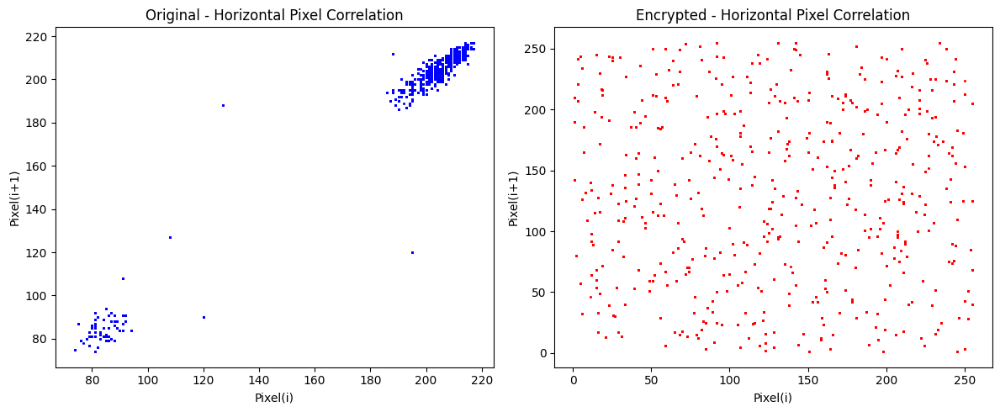

In [61]:
def plot_pixel_correlation(image1, image2, title1="Original", title2="Encrypted"):
    fig, axs = plt.subplots(1, 2, figsize=(12, 5))

    # Sample 5000 random neighboring pixel pairs (horizontal)
    h, w = image1.shape[:2]
    x = np.random.randint(0, h)
    y = np.random.randint(0, w - 1, 5000)

    orig_vals = image1[x, y, 0].flatten()
    orig_next = image1[x, y + 1, 0].flatten()
    enc_vals = image2[x, y, 0].flatten()
    enc_next = image2[x, y + 1, 0].flatten()

    axs[0].scatter(orig_vals, orig_next, s=1, color='blue')
    axs[0].set_title(f"{title1} - Horizontal Pixel Correlation")
    axs[0].set_xlabel('Pixel(i)')
    axs[0].set_ylabel('Pixel(i+1)')

    axs[1].scatter(enc_vals, enc_next, s=1, color='red')
    axs[1].set_title(f"{title2} - Horizontal Pixel Correlation")
    axs[1].set_xlabel('Pixel(i)')
    axs[1].set_ylabel('Pixel(i+1)')

    plt.tight_layout()
    plt.show()

plot_pixel_correlation(image, encrypted_image)


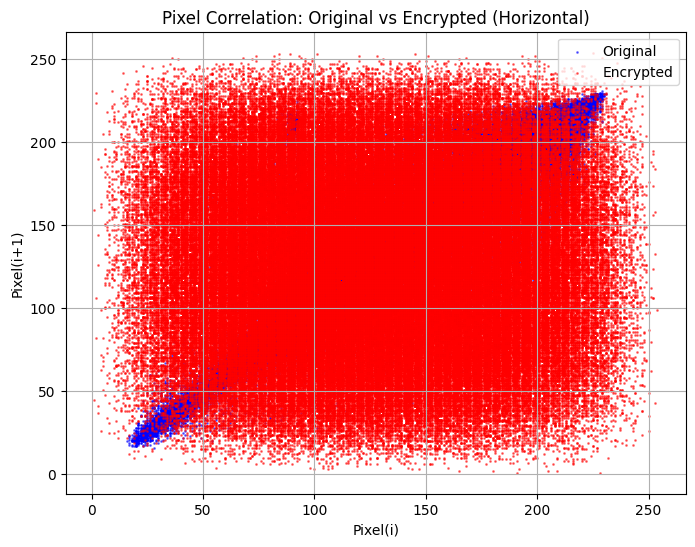

In [62]:
import numpy as np
import matplotlib.pyplot as plt

def get_adjacent_pixel_pairs(image_gray):
    # Flatten horizontal pixel pairs (Pixel(i), Pixel(i+1))
    pairs = np.column_stack((image_gray[:, :-1].ravel(), image_gray[:, 1:].ravel()))
    return pairs[:, 0], pairs[:, 1]

# Convert both images to grayscale if not already
gray_original = cv2.cvtColor(original_image, cv2.COLOR_BGR2GRAY)
gray_encrypted = cv2.cvtColor(encrypted_image, cv2.COLOR_BGR2GRAY)

# Get pixel pairs
orig_vals, orig_next = get_adjacent_pixel_pairs(gray_original)
enc_vals, enc_next = get_adjacent_pixel_pairs(gray_encrypted)

# Plot
plt.figure(figsize=(8, 6))
plt.scatter(orig_vals, orig_next, s=1, color='blue', alpha=0.5, label="Original")
plt.scatter(enc_vals, enc_next, s=1, color='red', alpha=0.5, label="Encrypted")
plt.xlabel('Pixel(i)')
plt.ylabel('Pixel(i+1)')
plt.legend(loc='best')
plt.title("Pixel Correlation: Original vs Encrypted (Horizontal)")
plt.grid(True)
plt.show()


## 2. Difference Image Heatmap

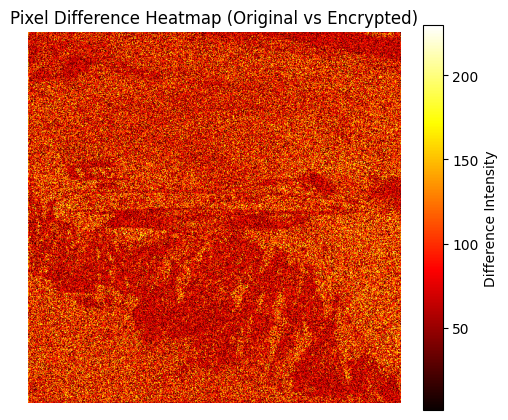

In [63]:
diff_image = cv2.absdiff(image, encrypted_image)
diff_gray = cv2.cvtColor(diff_image, cv2.COLOR_BGR2GRAY)

plt.figure(figsize=(6, 5))
plt.imshow(diff_gray, cmap='hot')
plt.title("Pixel Difference Heatmap (Original vs Encrypted)")
plt.colorbar(label='Difference Intensity')
plt.axis('off')
plt.show()


##  3. 3D Surface Plot of Histogram

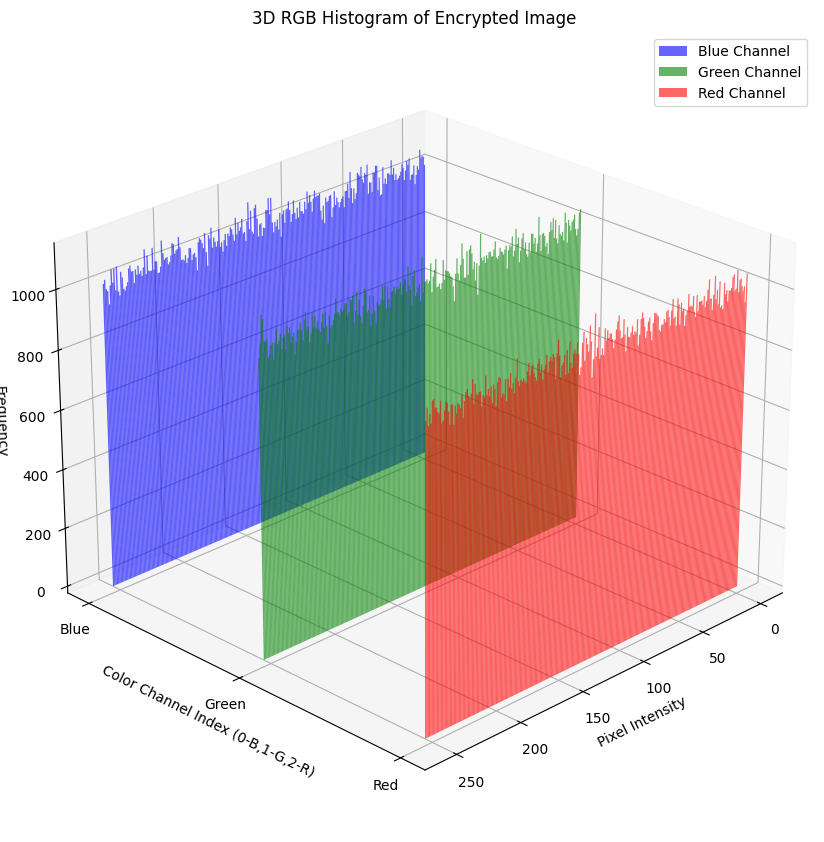

In [65]:
import numpy as np
import matplotlib.pyplot as plt
from mpl_toolkits.mplot3d import Axes3D
import cv2

# Ensure encrypted_image is loaded and is a color image (BGR format)

fig = plt.figure(figsize=(14, 10))
ax = fig.add_subplot(111, projection='3d')

bins = np.arange(256)
colors = ['blue', 'green', 'red']
channel_names = ['Blue', 'Green', 'Red']

for i, (color, name) in enumerate(zip(colors, channel_names)):
    hist = cv2.calcHist([encrypted_image], [i], None, [256], [0, 256]).flatten()
    ax.bar(bins, hist, zs=i, zdir='y', color=color, alpha=0.6, label=f'{name} Channel', width=1)

ax.set_xlabel('Pixel Intensity')
ax.set_ylabel('Color Channel Index (0-B,1-G,2-R)')
ax.set_zlabel('Frequency')
ax.set_yticks([0, 1, 2])
ax.set_yticklabels(channel_names)
ax.view_init(elev=25, azim=45)
ax.set_title("3D RGB Histogram of Encrypted Image")
ax.legend(loc='upper right')

plt.subplots_adjust(left=0.1, right=0.95, top=0.9, bottom=0.1)
plt.show()


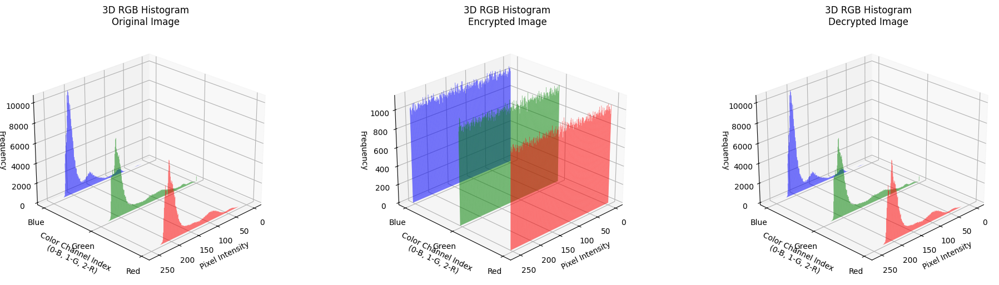

In [68]:
import numpy as np
import matplotlib.pyplot as plt
from mpl_toolkits.mplot3d import Axes3D
import cv2

# Assume these are already defined and in BGR format:
# original_image, encrypted_image, decrypted_image

images = [original_image, encrypted_image, decrypted_image]
titles = ["Original Image", "Encrypted Image", "Decrypted Image"]

fig = plt.figure(figsize=(20, 6))
bins = np.arange(256)
colors = ['blue', 'green', 'red']
channel_names = ['Blue', 'Green', 'Red']

for idx, (img, title) in enumerate(zip(images, titles)):
    ax = fig.add_subplot(1, 3, idx + 1, projection='3d')
    
    for i, (color, name) in enumerate(zip(colors, channel_names)):
        hist = cv2.calcHist([img], [i], None, [256], [0, 256]).flatten()
        ax.bar(bins, hist, zs=i, zdir='y', color=color, alpha=0.6, width=1)

    ax.set_xlabel('Pixel Intensity')
    ax.set_ylabel('Color Channel Index\n(0-B, 1-G, 2-R)')
    ax.set_zlabel('Frequency')
    ax.set_yticks([0, 1, 2])
    ax.set_yticklabels(channel_names)
    ax.set_title(f"3D RGB Histogram\n{title}")
    ax.view_init(elev=25, azim=45)

# Replace tight_layout with manual adjustment
plt.subplots_adjust(left=0.05, right=0.95, top=0.85, bottom=0.1, wspace=0.3)
plt.show()


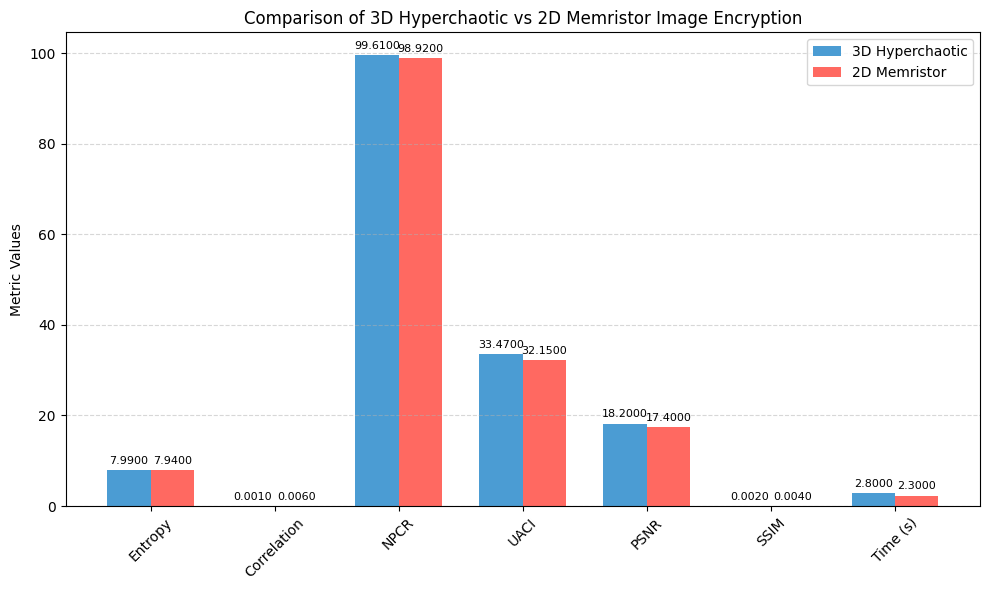

In [2]:
import matplotlib.pyplot as plt
import numpy as np

# Metrics to compare
metrics = [
    "Entropy",
    "Correlation",
    "NPCR",
    "UACI",
    "PSNR",
    "SSIM",
    "Time (s)"
]

# Sample values (you can replace these with actual values from your analysis)
hyperchaotic_values = [7.99, 0.001, 99.61, 33.47, 18.2, 0.002, 2.8]
memristor_values = [7.94, 0.006, 98.92, 32.15, 17.4, 0.004, 2.3]

x = np.arange(len(metrics))
width = 0.35

# Plotting
fig, ax = plt.subplots(figsize=(10, 6))
bars1 = ax.bar(x - width/2, hyperchaotic_values, width, label='3D Hyperchaotic', color='#4B9CD3')
bars2 = ax.bar(x + width/2, memristor_values, width, label='2D Memristor', color='#FF6961')

# Add labels and titles
ax.set_ylabel('Metric Values')
ax.set_title('Comparison of 3D Hyperchaotic vs 2D Memristor Image Encryption')
ax.set_xticks(x)
ax.set_xticklabels(metrics, rotation=45)
ax.legend()
ax.grid(axis='y', linestyle='--', alpha=0.5)

# Annotate values on top of bars
for bar in bars1 + bars2:
    height = bar.get_height()
    ax.annotate(f'{height:.4f}', xy=(bar.get_x() + bar.get_width() / 2, height),
                xytext=(0, 3), textcoords="offset points",
                ha='center', va='bottom', fontsize=8)

plt.tight_layout()
plt.show()
